# SVGD 
Adapted from [here](https://colab.research.google.com/github/activatedgeek/stein-gradient/blob/master/Stein.ipynb#scrollTo=-c6hPMDLqceL).

Code by the authors of the original paper is avaiable [here](https://github.com/dilinwang820/Stein-Variational-Gradient-Descent).

In [1]:
%load_ext autoreload
%autoreload 2
import sys
sys.path.append("..")

from src.kernel import RBF
from src.svgd import SVGD
from src.gsvgd import GSVGD
from experiments.utils import GaussianMixture

import math
import autograd.numpy as np
import pandas as pd

import torch
import torch.autograd as autograd
import torch.optim as optim
from torch.distributions import MultivariateNormal
from torch import einsum

from pymanopt.manifolds import Grassmann
from pymanopt import Problem
from pymanopt.solvers import SteepestDescent

import altair as alt
import matplotlib.pyplot as plt
import seaborn as sns

alt.data_transformers.enable('default', max_rows=None)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

## Mixture of Gaussians (1D)

In [2]:
K = RBF()

In [3]:
mean = torch.Tensor([[-2.], [2.]]).to(device)
covariance = torch.Tensor([1.]).repeat(2, 1, 1).to(device)
prob = torch.K = RBF()

mean = torch.Tensor([[-2.], [2.]]).to(device)
covariance = torch.Tensor([1.]).repeat(2, 1, 1).to(device)
prob = torch.Tensor([[1/3], [2/3]])

gaussian_mix = GaussianMixture(mean=mean, covariance_matrix=covariance, prob=prob)

n = 1000
q_mean = -10 
q_var = 1

# sample from variational density
x_init = q_mean + q_var * torch.randn(n, *gaussian_mix.event_shape)

x = x_init.clone()
lr = 1e-1
epochs = 1000

svgd = SVGD(gaussian_mix, K, optim.Adam([x], lr=lr))
svgd.fit(x, epochs)


100%|██████████| 1000/1000 [00:31<00:00, 31.92it/s]


Text(0.5, 1.0, 'final particles')

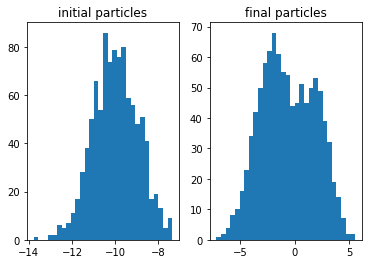

In [4]:
plt.subplot(1, 2, 1)
plt.hist(x_init.cpu().numpy(), bins=30)
plt.title("initial particles")
plt.subplot(1, 2, 2)
plt.hist(x.cpu().numpy(), bins=30)
plt.title("final particles")



## Mixture of Gaussians (2D)

In [12]:
kernel = RBF()

In [37]:
gauss = torch.distributions.MultivariateNormal(
    loc = torch.Tensor([-0.6871,0.8010]),
    covariance_matrix = 5 * torch.Tensor([[0.2260,0.1652],[0.1652,0.6779]]).to(device)
)

n = 100
x_init = (3 * torch.randn(n, *gauss.event_shape)).to(device)

In [38]:
gauss_chart = get_density_chart(gauss, d=7.0, step=0.1)
gauss_chart + get_particles_chart(x_init.cpu().numpy())

alt.LayerChart(...)

In [39]:
x = x_init.clone()
svgd = SVGD(gauss, kernel, optim.Adam([x], lr=1e-1))
svgd.fit(x, 1000)

In [40]:
gauss_chart + get_particles_chart(x.cpu().numpy())

alt.LayerChart(...)

In [41]:
x_final = x.cpu().numpy().copy()
x_true = gauss.sample((10000,))

[(-5.0, 6.0), (-5.0, 3.0), Text(0.5, 1.0, 'True density')]

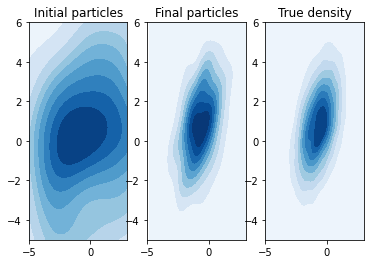

In [42]:
ylims = [-5, 6]
xlims = [-5, 3]

plt.subplot(1, 3, 1)
g1 = sns.kdeplot(x=x_init[:, 0], y=x_init[:, 1], cmap="Blues", shade=True, thresh=0)
g1.set(ylim=ylims, xlim=xlims, title="Initial particles")

plt.subplot(1, 3, 2)
g2 = sns.kdeplot(x=x_final[:, 0], y=x_final[:, 1], cmap="Blues", shade=True, thresh=0)
g2.set(ylim=ylims, xlim=xlims, title="Final particles")

plt.subplot(1, 3, 3)
g3 = sns.kdeplot(x=x_true[:, 0], y=x_true[:, 1], cmap="Blues", shade=True, thresh=0)
g3.set(ylim=ylims, xlim=xlims, title="True density")

# Manually checking each term in alpha()

In [4]:
k = RBF()

def alpha(x0, P0, score_func):
    # Px
    y0 = einsum("ij, jk -> ik", x0.detach(), P0).requires_grad_(True)
    
    # score
    log_prob = gauss.log_prob(x0)
    score = autograd.grad(log_prob.sum(), x0)[0]
    P_score = einsum("ij, jk -> ik", score, P0)

    # Gram matrix
    K_xx = k(x0, x0.detach())
    K_PxPx = k(y0, y0.detach())
    grad_K_Px = autograd.grad(K_PxPx.sum(), y0)[0]

    # term 1
    prod = einsum("ij, ij -> ij", P_score @ score.T, K_PxPx)
    term1 = prod.sum()

    # term 2
    term2 = einsum("ii -> ", P_score @ grad_K_Px.T)
    # ---

    # term 3
    gradgrad_K_PxPx = autograd.functional.jacobian(
        lambda u: k.grad(u, y0.detach()), y0)
    gradgrad_K_PxPx =  gradgrad_K_PxPx.sum(-2)
    P_gradgrad_K = einsum("ij, jklm -> iklm", P0, gradgrad_K_PxPx)
    term3 = einsum("ijki -> ", P_gradgrad_K)

    return((term1 + term2 + term3) / x.shape[0]**2)

In [5]:
P = torch.Tensor([[1, 1], [1, 1]]).requires_grad_(True)
x = torch.Tensor([[1, 0], [0, 1], [1, 2]]).requires_grad_(True)
gauss = torch.distributions.MultivariateNormal(
    loc = torch.Tensor([-0.6871,0.8010]),
    covariance_matrix = 5 * torch.Tensor([[0.2260,0.1652],[0.1652,0.6779]]).to(device)
)

In [6]:
_ = alpha(x, P, gauss)
_

tensor(2.1824, grad_fn=<DivBackward0>)

In [7]:
# grad grad K
def grad_grad_K_fn(x1, x2):
    norm_2 = (x1 - x2) @ (x1 - x2).t()
    inv_sigma = 1 / (k.sigma**2)
    res = torch.Tensor([
        [
            (-inv_sigma**2 * (x2[0, 0] - x1[0, 0])**2 + inv_sigma) * (- 0.5 * inv_sigma * norm_2).exp(),
            inv_sigma * (x2[0, 0] - x1[0, 0])*(x1[0, 1] - x2[0, 1]) * (- 0.5 * inv_sigma * norm_2).exp(),
        ],
        [
            inv_sigma * (x2[0, 1] - x1[0, 1])*(x1[0, 0] - x2[0, 0]) * (- 0.5 * inv_sigma * norm_2).exp(),
            (inv_sigma**2 * (x2[0, 1] - x1[0, 1])*(x1[0, 1] - x2[0, 1]) + inv_sigma) * (- 0.5 * inv_sigma * norm_2).exp(),
        ]
    ])
    return(res)

In [8]:
# term3
s = 0
y = x @ P
K_PxPx = k(y, y.detach())
grad_K_Px = autograd.grad(K_PxPx.sum(), y)[0]

for i in range(3):
    for j in range(3):
        yi = y[i, :].reshape(1, -1).detach().requires_grad_(True)
        yj = y[j, :].reshape(1, -1).detach().requires_grad_(True)
        gradgrad_K_PxPx = grad_grad_K_fn(yi, yj)
        term_prod = P @ gradgrad_K_PxPx
        term = einsum("ii -> ", term_prod)
        s += term
        print(term)
    
print("s:", s)

tensor(2.7726, grad_fn=<ViewBackward>)
tensor(2.7726, grad_fn=<ViewBackward>)
tensor(-0.0925, grad_fn=<ViewBackward>)
tensor(2.7726, grad_fn=<ViewBackward>)
tensor(2.7726, grad_fn=<ViewBackward>)
tensor(-0.0925, grad_fn=<ViewBackward>)
tensor(-0.0925, grad_fn=<ViewBackward>)
tensor(-0.0925, grad_fn=<ViewBackward>)
tensor(2.7726, grad_fn=<ViewBackward>)
s: tensor(13.4928, grad_fn=<AddBackward0>)


In [12]:
# term3
s = 0
y = x @ P
K_PxPx = k(y, y.detach())
grad_K_Px = autograd.grad(K_PxPx.sum(), y)[0]

for i in range(3):
    for j in range(3):
        gradgrad_K_PxPx = autograd.functional.jacobian(
            lambda u: k.grad(u, y[j, :].detach().reshape(1, -1)), y[i, :].reshape(1, -1))
        gradgrad_K_PxPx = gradgrad_K_PxPx.sum(-2).squeeze(1).squeeze(1)
        term_prod = P @ gradgrad_K_PxPx
        term = einsum("ii -> ", term_prod)
        s += term
        print(term)
    
print("s:", s)

tensor(2.7726, grad_fn=<ViewBackward>)
tensor(2.7726, grad_fn=<ViewBackward>)
tensor(-0.0009, grad_fn=<ViewBackward>)
tensor(2.7726, grad_fn=<ViewBackward>)
tensor(2.7726, grad_fn=<ViewBackward>)
tensor(-0.0009, grad_fn=<ViewBackward>)
tensor(-0.0009, grad_fn=<ViewBackward>)
tensor(-0.0009, grad_fn=<ViewBackward>)
tensor(2.7726, grad_fn=<ViewBackward>)
s: tensor(13.8594, grad_fn=<AddBackward0>)


In [13]:
# term2
s = 0
log_prob = gauss.log_prob(x)
score = autograd.grad(log_prob.sum(), x)[0]
P_score = score @ P
y = x @ P
K_PxPx = k(y, y.detach())
grad_K_Px = autograd.grad(K_PxPx.sum(), y)[0]

for i in range(3):
    term = P_score[i, :] @ grad_K_Px[i, :].t()
    s += term
    print(term)
    
print("s:", s)

tensor(-0.0281, grad_fn=<DotBackward>)
tensor(-0.0125, grad_fn=<DotBackward>)
tensor(0.0645, grad_fn=<DotBackward>)
s: tensor(0.0239, grad_fn=<AddBackward0>)


In [14]:
# term1
s = 0
log_prob = gauss.log_prob(x)
score = autograd.grad(log_prob.sum(), x)[0]
P_score = score @ P
y = x @ P
K_PxPx = k(y, y.detach())
grad_K_Px = autograd.grad(K_PxPx.sum(), y)[0]

    
for i in range(3):
    for j in range(3):
        term = (P_score[i, :] @ score[j, :].t()) * K_PxPx[i, j]
        s += term
        print(term)
        
print("s:", s)

tensor(1.6811, grad_fn=<MulBackward0>)
tensor(0.7504, grad_fn=<MulBackward0>)
tensor(0.0075, grad_fn=<MulBackward0>)
tensor(0.7504, grad_fn=<MulBackward0>)
tensor(0.3350, grad_fn=<MulBackward0>)
tensor(0.0034, grad_fn=<MulBackward0>)
tensor(0.0075, grad_fn=<MulBackward0>)
tensor(0.0034, grad_fn=<MulBackward0>)
tensor(2.2192, grad_fn=<MulBackward0>)
s: tensor(5.7579, grad_fn=<AddBackward0>)


In [34]:
# grad_K
ind1 = 2
ind2 = 0
# xx = x[ind1, :] @ P
# yy = x[ind2, :] @ P
s = 0
for i in range(3):
#     xx = x[i, :]
#     yy = x[ind2, :]
    xx = x[i, :] @ P
    yy = x[ind2, :] @ P
    term = - 1/k.sigma**2 * (yy - xx) * (- 1 / (2 * k.sigma**2) * ((xx - yy) @ (xx - yy).t()) ).exp()
    print(term)
    s += term   
s

tensor([-0., -0.], grad_fn=<MulBackward0>)
tensor([-0., -0.], grad_fn=<MulBackward0>)
tensor([0.0108, 0.0108], grad_fn=<MulBackward0>)


tensor([0.0108, 0.0108], grad_fn=<AddBackward0>)

In [3]:
P = torch.Tensor([[1, 1], [1, 1]]).requires_grad_(True)
x = torch.Tensor([[1, 0], [0, 1], [1, 2]]).requires_grad_(True)
k = RBF()
manifold = Grassmann(2, 1)
gauss = torch.distributions.MultivariateNormal(
    loc = torch.Tensor([-0.6871,0.8010]),
    covariance_matrix = 5 * torch.Tensor([[0.2260,0.1652],[0.1652,0.6779]]).to(device)
)
gsvgd = GSVGD(
    target = gauss,
    kernel = k,
    manifold = manifold,
    optimizer = optim.Adam([x], lr=1e-1))


In [4]:
gsvgd.alpha(x, P)

tensor(2.1342, grad_fn=<DivBackward0>)

In [ ]:
alpha = gsvgd.alpha(x, P)
autograd.grad(alpha, P)

$P = A A^T, A \in \mathbb{R}^{d \times k}$

$I_d = A^T A$


$U D U^T, A = U D^{1/2}$

In [6]:
from experiments.utils import GaussianMixture
from src.kernel import RBF

In [25]:
num_particles = 
mean = torch.Tensor([[-2.0, 0.0], [4.0, 0.0]])
covariance = torch.Tensor([[1.0, 0.0], [0.0, 1.0]]).repeat(2, 1, 1)
prob = torch.Tensor([[1 / 3], [2 / 3]])
gaussian_mix = GaussianMixture(mean=mean, covariance_matrix=covariance, prob=prob)

In [26]:
k = RBF()
manifold = Grassmann(2, 1)

In [27]:
x_init = torch.randn(num_particles, *gaussian_mix.event_shape)
x = x_init.clone()
A = torch.Tensor([[1], [1]]).requires_grad_(True)
gsvgd = GSVGD(
    target=gaussian_mix,
    kernel=k,
    manifold=manifold,
    optimizer=optim.Adam([x], lr=1e-1),
)

In [28]:
gsvgd.fit(x, A, epochs=100)

100%|██████████| 100/100 [01:04<00:00,  1.56it/s]


In [17]:
import altair as alt
alt.data_transformers.enable('default', max_rows=None)
def get_density_chart(P, d=7.0, step=0.1):
    xv, yv = torch.meshgrid([
      torch.arange(-d, d, step), 
      torch.arange(-d, d, step)
    ])
    pos_xy = torch.cat((xv.unsqueeze(-1), yv.unsqueeze(-1)), dim=-1)
    p_xy = P.log_prob(pos_xy).exp().unsqueeze(-1).cpu()

    df = torch.cat([pos_xy, p_xy], dim=-1).numpy()
    df = pd.DataFrame({
      'x': df[:, :, 0].ravel(),
      'y': df[:, :, 1].ravel(),
      'p': df[:, :, 2].ravel(),
    })

    chart = alt.Chart(df).mark_point().encode(
    x='x:Q',
    y='y:Q',
    color=alt.Color('p:Q', scale=alt.Scale(scheme='viridis')),
    tooltip=['x','y','p']
    )

    return chart


def get_particles_chart(X):
    df = pd.DataFrame({
      'x': X[:, 0],
      'y': X[:, 1],
    })

    chart = alt.Chart(df).mark_circle(color='red').encode(
    x='x:Q',
    y='y:Q'
    )

    return chart

In [18]:
fig = get_density_chart(gaussian_mix, d=12.0, step=0.1)

(fig + get_particles_chart(x_init.cpu().numpy())) | (fig + get_particles_chart(x.cpu().numpy()))

alt.HConcatChart(...)

In [19]:
gsvgd.fit(x, A, epochs=100)

100%|██████████| 100/100 [00:05<00:00, 18.41it/s]


In [20]:
fig2 = get_density_chart(gaussian_mix, d=12.0, step=0.1)

(fig2 + get_particles_chart(x_init.cpu().numpy())) | (fig2 + get_particles_chart(x.cpu().numpy()))

alt.HConcatChart(...)

In [74]:
num_particles = 20
mean = torch.Tensor([[-2.0, 0.0], [4.0, 0.0]])
covariance = torch.Tensor([[1.0, 0.0], [0.0, 1.0]]).repeat(2, 1, 1)
prob = torch.Tensor([[1 / 3], [2 / 3]])
gaussian_mix = GaussianMixture(mean=mean, covariance_matrix=covariance, prob=prob)

In [75]:
x_init = torch.randn(num_particles, *gaussian_mix.event_shape)

In [84]:
x_svgd = x_init.clone()
x_gsvgd = x_init.clone()

# A = torch.Tensor([[1], [1]]).requires_grad_(True)
A = torch.Tensor([[1, 0], [0, 1]]).requires_grad_(True)

AttributeError: 'Tensor' object has no attribute 'copy'

In [ ]:
k1 = RBF()
svgd = SVGD(
    target=gaussian_mix,
    kernel=k1,
    optimizer=optim.Adam([x_svgd], lr=1e-1)
)

k2 = RBF()
manifold = Grassmann(2, 2)
gsvgd = GSVGD(
    target=gaussian_mix,
    kernel=k2,
    manifold=manifold,
    optimizer=optim.Adam([x_gsvgd], lr=1e-1),
)

In [85]:
svgd.fit(x_svgd, epochs=100)

100%|██████████| 100/100 [00:00<00:00, 345.15it/s]


In [79]:
gsvgd.fit(x_gsvgd, A, epochs=100)

100%|██████████| 100/100 [01:07<00:00,  1.49it/s]


In [80]:
fig_svgd = get_density_chart(gaussian_mix, d=12.0, step=0.1)

(fig_svgd + get_particles_chart(x_init.cpu().numpy())) | (fig_svgd + get_particles_chart(x_svgd.cpu().numpy()))

alt.HConcatChart(...)

In [81]:
fig_gsvgd = get_density_chart(gaussian_mix, d=12.0, step=0.1)

(fig_gsvgd + get_particles_chart(x_init.cpu().numpy())) | (fig_gsvgd + get_particles_chart(x_gsvgd.cpu().numpy()))

alt.HConcatChart(...)

In [82]:
x_svgd

tensor([[-2.2041,  0.4762],
        [-4.1421,  0.1297],
        [-2.3569, -0.4738],
        [-1.5938, -1.0762],
        [-3.6890,  1.3588],
        [-2.5752,  1.7386],
        [-2.6829, -1.4442],
        [-1.4528,  2.0834],
        [-0.5198, -0.6435],
        [-0.4344,  1.3464],
        [ 0.1755,  0.2039],
        [-1.6320,  1.0640],
        [-2.9942,  0.6164],
        [-1.8795, -2.1462],
        [-0.9319,  0.3918],
        [-3.7685, -1.2569],
        [-3.1916, -0.3441],
        [ 3.9845, -0.0071],
        [-0.6786, -1.7024],
        [-1.5298, -0.1828]])

In [83]:
x_gsvgd

tensor([[-2.2041,  0.4762],
        [-4.1421,  0.1297],
        [-2.3569, -0.4738],
        [-1.5938, -1.0762],
        [-3.6890,  1.3588],
        [-2.5752,  1.7386],
        [-2.6829, -1.4442],
        [-1.4528,  2.0834],
        [-0.5198, -0.6435],
        [-0.4344,  1.3464],
        [ 0.1755,  0.2039],
        [-1.6320,  1.0640],
        [-2.9942,  0.6164],
        [-1.8795, -2.1462],
        [-0.9319,  0.3918],
        [-3.7685, -1.2569],
        [-3.1916, -0.3441],
        [ 3.9845, -0.0071],
        [-0.6786, -1.7024],
        [-1.5298, -0.1828]])

In [7]:
# x =torch.randn(num_particles, *gaussian_mix.event_shape) # 5x2
# y =torch.randn(num_particles, *gaussian_mix.event_shape)
P = torch.Tensor([[1, 1], [1, 1]]).requires_grad_(True)
A = torch.Tensor([[1], [1]]).requires_grad_(True)
x = torch.Tensor([[1, 0], [0, 1], [1, 2]]).requires_grad_(True)
y0 = x

kernel = RBF()
_ = kernel.forward(y0, y0)
inv_sigma = 1 / (kernel.sigma ** 2)

# diff = y0[:, 0] - y0[:, 1].view(-1, 1)

In [36]:
xx = torch.Tensor([[1, 0], [0, 1], [1, 2]])
yy = torch.Tensor([[1, 0], [1, 1]])

kernel = RBF()

kernel(x, y)

tensor([[0., 1.],
        [2., 1.],
        [4., 1.]])


tensor([[1.0000, 0.6065],
        [0.3679, 0.6065],
        [0.1353, 0.6065]])

In [239]:
from src.kernel_minibatch import RBF

In [240]:
x = torch.Tensor([[[1, 0], [0, 1], [1, 2]]])
y = torch.Tensor([[[1, 0], [1, 1], [2, 1], [3, 1]]])

kernel = RBF()

In [241]:
X = x
Y = y
XX = X.matmul(torch.transpose(X, 1, 2))
XY = X.matmul(torch.transpose(Y, 1, 2))
YY = Y.matmul(torch.transpose(Y, 1, 2))

In [244]:
sigma_inv2 = 1 / (1e-8 + kernel.sigma ** 2)
a = (-l2norm(X, Y) * 0.5 * sigma_inv2).exp().unsqueeze(0)
# [diff]_{ijk} = y^i_j - x^i_k
diff = (X - Y.unsqueeze(Y.shape[-1])).transpose(1, -1)
# product of differences
diff_outerprod = - diff.unsqueeze(1) * diff.unsqueeze(2)
# compute gradgrad_K
# TODO: How do we avoid doing to(device)??
diag = sigma_inv2 * torch.eye(X.shape[-1], device=X.device).unsqueeze(-1).unsqueeze(-1)
gradgrad_K_all = (diag + sigma_inv2 ** 2 * diff_outerprod) * a

In [248]:
gradgrad_K_all.shape

torch.Size([1, 2, 2, 3, 4])

In [249]:
a.shape

torch.Size([1, 1, 3, 4])

In [250]:
kernel.grad_second(x, y).shape

torch.Size([1, 2, 3, 4])

In [251]:
kernel.gradgrad(x, y).shape

torch.Size([1, 2, 2, 3, 4])

# previous implementation

In [215]:
from src.kernel import RBF
kernel2 = RBF()
kernel2(xx, yy)
kernel2.gradgrad(xx, yy)[:, :, 0, 1]

tensor([[0.6065, 0.0000],
        [0.0000, 0.0000]])